In [1]:
import numpy as np
import pandas as pd
import tensorflow as tf
tf.config.run_functions_eagerly(True)
from matplotlib import pyplot as plt
from skimage import exposure
from PIL import Image
import os
import cv2
from sklearn.metrics import accuracy_score
import shutil
import random
from sklearn.metrics import confusion_matrix
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import classification_report
import umap
import seaborn as sns

c:\Users\SANKARAN\anaconda3\envs\tf_gpu\lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
with open("../1_Fetal_gradcams/manual_annot_CRL_Sagittal.txt", "r") as file:
    # Read the contents of the file
    file_contents = file.read()
lines = file_contents.split('\n')
index = [int(i.split(' ')[0]) for i in lines]
labels = [' '.join(i.split(' ')[1:]) for i in lines]
manual_labels_df = pd.DataFrame()
manual_labels_df['Image ID'] = index
manual_labels_df['label'] = labels

manual_labels_df['label'] = manual_labels_df['label'].apply(lambda x: x.strip())

manual_labels_df = manual_labels_df[manual_labels_df['label'] != 'remove']

num_labels = {'head': 0, 'neck': 1, 'body': 2}

manual_labels_df['encoded_label'] = manual_labels_df['label'].map(num_labels)

y = np.array(manual_labels_df['encoded_label'])

In [3]:
imgs = np.load('../1_Fetal_gradcams/filtered_CRL_Sagittal_fetal_parts.npy')

In [4]:
min_angle = -30
max_angle = 30

def rotate_image(image, angle):
    # Get image center coordinates
    center = (image.shape[1] / 2, image.shape[0] / 2)

    # Perform the rotation
    rotation_matrix = cv2.getRotationMatrix2D(center, angle, 1.0)
    rotated_image = cv2.warpAffine(image, rotation_matrix, (image.shape[1], image.shape[0]))

    return rotated_image
rotated_images = []
for img in imgs:
    angle = random.uniform(min_angle, max_angle)
    rotated_img = rotate_image(img, angle)
    rotated_images.append(rotated_img)

rotated_images = np.array(rotated_images)

In [5]:
x = np.concatenate((imgs, rotated_images), axis=0)
y =  np.concatenate((y, y), axis=0)

In [6]:
from sklearn.model_selection import train_test_split as tts
x_train, x_test, y_train, y_test = tts(x, y, test_size=0.2, random_state=42)

In [7]:
print(x_train.shape, y_train.shape)

(288, 224, 224, 3) (288,)


In [8]:
labels = {
    0: 'head',
    1: 'neck',
    2: 'body'
}

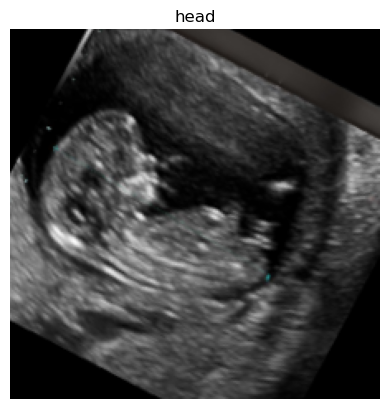

In [9]:
idx = random.randint(0, y_train.shape[0])
plt.title(labels[y_train[idx]])
plt.imshow(x_train[idx])
plt.axis('off');

## Building a Densenet model for this task 

In [10]:
from tensorflow.keras.applications.densenet import DenseNet121
IMG_SIZE = 224
NUM_CLASSES = 3

In [11]:
def build_base_model():

    backbone_model = DenseNet121(
        include_top=False,
        weights="imagenet",
        input_tensor=tf.keras.layers.Input(shape=(IMG_SIZE,IMG_SIZE,3))
    )

    flat = tf.keras.layers.Flatten()(backbone_model.output)
    dense = tf.keras.layers.Dense(256, activation='relu')(flat)
    classifier = tf.keras.layers.Dense(NUM_CLASSES, activation='softmax')(dense)

    model = tf.keras.models.Model(inputs = backbone_model.input, outputs = classifier)
    optimizer = tf.keras.optimizers.Adam(learning_rate=1e-4)
    model.compile(optimizer=optimizer,loss='categorical_crossentropy', metrics = ['accuracy'])

    return model

In [12]:
global_model = build_base_model()

In [13]:
for (i, l) in enumerate(global_model.layers):
    if i <= 426:
        l.trainable = False
    print(i, l.name, l.trainable)

0 input_1 False
1 zero_padding2d False
2 conv1/conv False
3 conv1/bn False
4 conv1/relu False
5 zero_padding2d_1 False
6 pool1 False
7 conv2_block1_0_bn False
8 conv2_block1_0_relu False
9 conv2_block1_1_conv False
10 conv2_block1_1_bn False
11 conv2_block1_1_relu False
12 conv2_block1_2_conv False
13 conv2_block1_concat False
14 conv2_block2_0_bn False
15 conv2_block2_0_relu False
16 conv2_block2_1_conv False
17 conv2_block2_1_bn False
18 conv2_block2_1_relu False
19 conv2_block2_2_conv False
20 conv2_block2_concat False
21 conv2_block3_0_bn False
22 conv2_block3_0_relu False
23 conv2_block3_1_conv False
24 conv2_block3_1_bn False
25 conv2_block3_1_relu False
26 conv2_block3_2_conv False
27 conv2_block3_concat False
28 conv2_block4_0_bn False
29 conv2_block4_0_relu False
30 conv2_block4_1_conv False
31 conv2_block4_1_bn False
32 conv2_block4_1_relu False
33 conv2_block4_2_conv False
34 conv2_block4_concat False
35 conv2_block5_0_bn False
36 conv2_block5_0_relu False
37 conv2_block5_1_

In [14]:
EPOCHS = 50
earlystop = tf.keras.callbacks.EarlyStopping(patience=10)
learning_rate_reduction = tf.keras.callbacks.ReduceLROnPlateau(monitor='val_accuracy',
                                            patience=5,
                                            verbose=1,
                                            factor=0.2,
                                            min_lr=1e-6)
mycallbacks = [earlystop, learning_rate_reduction]

In [15]:
y_train_onehot = tf.keras.utils.to_categorical(y_train, num_classes=3)
y_test_onehot = tf.keras.utils.to_categorical(y_test, num_classes=3)

In [16]:
print(y_train_onehot.shape, y_test_onehot.shape)

(288, 3) (72, 3)


In [21]:
x_train = x_train/255.
x_test = x_test/255.

In [ ]:
# # from scratch
# history = global_model.fit(
#     x_train,
#     y_train_onehot,
#     epochs=EPOCHS,
#     validation_data=(x_test, y_test_onehot),
#     callbacks=mycallbacks,
#     batch_size = 2
# )

In [23]:
from tensorflow.keras.models import load_model
global_model = load_model('3_fetal_parts_gradcam_uncropped.h5', compile = False)
optimizer = tf.keras.optimizers.Adam(learning_rate=1e-4)
global_model.compile(optimizer=optimizer,loss='categorical_crossentropy', metrics = ['accuracy'])

In [24]:
score = global_model.evaluate(x_test, y_test_onehot, verbose=0)
print("Test loss:", score[0])
print("Test accuracy:", score[1])

c:\Users\SANKARAN\anaconda3\envs\tf_gpu\lib\site-packages\tensorflow\python\data\ops\structured_function.py:264: UserWarning: Even though the `tf.config.experimental_run_functions_eagerly` option is set, this option does not apply to tf.data functions. To force eager execution of tf.data functions, please use `tf.data.experimental.enable_debug_mode()`.
  warnings.warn(


Test loss: 0.1613413691520691
Test accuracy: 0.9305555820465088


In [28]:
score = global_model.evaluate(x_train, y_train_onehot, verbose=0)
print("Train loss:", score[0])
print("Train accuracy:", score[1])

Train loss: 0.14007560908794403
Train accuracy: 0.9618055820465088


### GradCAM visualizer

In [29]:
@tf.function
def normalize(heatmap):
    num = heatmap - tf.reduce_min(heatmap)
    deno = (tf.reduce_max(heatmap) - tf.reduce_min(heatmap))
    if deno == 0:
        return heatmap
    heatmap = num / deno
    return heatmap

In [30]:
@tf.function
def compute_gradcam_map(model, image, eps=1e-8):
    gradModel = tf.keras.models.Model(
        inputs=[model.inputs],
        outputs=[model.get_layer(get_last_layer_name(model)).output, model.output]
    )
    gradModel.layers[-1].activation = tf.keras.activations.linear

    with tf.GradientTape(persistent = True) as tape:
        input_image = tf.cast(image, tf.float32)
        convOutputs, predictions = gradModel(input_image, training=False)
        classid = tf.argmax(predictions[0])
        loss = predictions[:, classid]

    grads = tape.gradient(loss, convOutputs)

    pooled_grads = tf.reduce_mean(grads, axis = (0, 1, 2))

    convOutputs = convOutputs[0]
    heatmap = convOutputs @ pooled_grads[..., tf.newaxis]
    heatmap = tf.squeeze(heatmap)

    heatmap = tf.image.resize(heatmap[tf.newaxis, ..., tf.newaxis], [IMG_SIZE, IMG_SIZE])
    heatmap = tf.squeeze(heatmap)

    heatmap = normalize(heatmap)
    return heatmap

In [31]:
@tf.function
def get_last_layer_name(model):
    for layer in reversed(model.layers):
        if isinstance(layer, tf.keras.layers.Conv2D):
            return layer.name
    return []
#     return model.get_layer(index=47).name

In [32]:
@tf.function
def generate_gradcam(img, label, global_model):
    fused_heatmap = compute_gradcam_map(global_model, img)
    return fused_heatmap

In [33]:
@tf.function
def generate_gradcam_batch(imgs, global_model, threshold):

    fused_heatmaps = []
    for image in imgs:
        heatmap = compute_gradcam_map(global_model, tf.expand_dims(image, axis=0))
        fused_heatmaps.append(heatmap)

    # Generate mask from combination
    fused_heatmaps = tf.convert_to_tensor(fused_heatmaps, tf.float32)
    return fused_heatmaps

In [34]:
def overlay_heatmap(image, heatmap, alpha=0.7,colormap=cv2.COLORMAP_JET):
    heatmap = cv2.cvtColor(cv2.applyColorMap((heatmap * 255.).astype("uint8"), colormap), cv2.COLOR_BGR2RGB)
    output = cv2.addWeighted((image * 255.).astype("uint8"), alpha, heatmap, 1 - alpha, 0)
    return output

In [51]:
test_heatmaps = generate_gradcam_batch(x_test, global_model, 0.6)

In [52]:
len(test_heatmaps)

72

In [63]:
test_overlaid = [overlay_heatmap(img, hmap.numpy()) for (img, hmap) in zip(x_test, test_heatmaps)]

### Manually verifying the region of activation on the test set 

In [58]:
test_preds_onehot = global_model.predict(x_test)

c:\Users\SANKARAN\anaconda3\envs\tf_gpu\lib\site-packages\tensorflow\python\data\ops\structured_function.py:264: UserWarning: Even though the `tf.config.experimental_run_functions_eagerly` option is set, this option does not apply to tf.data functions. To force eager execution of tf.data functions, please use `tf.data.experimental.enable_debug_mode()`.
  warnings.warn(


3/3 [==============================] - 1s 360ms/step


In [59]:
test_preds = np.argmax(test_preds_onehot, axis = 1)

In [61]:
# Accuracy measure
print("Testing accuracy is: ", round(accuracy_score(test_preds, y_test)*100, 4), " %")

Testing accuracy is:  93.0556  %


C:\Users\SANKARAN\AppData\Local\Temp\ipykernel_19864\347369745.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(15, 5))


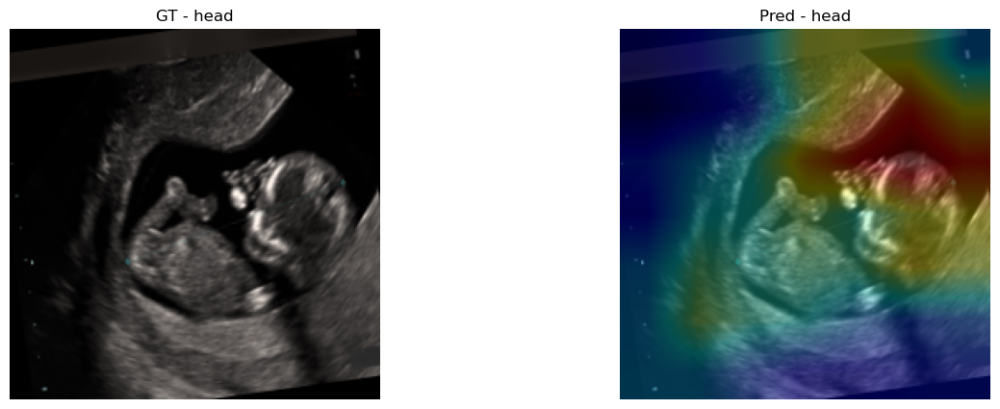

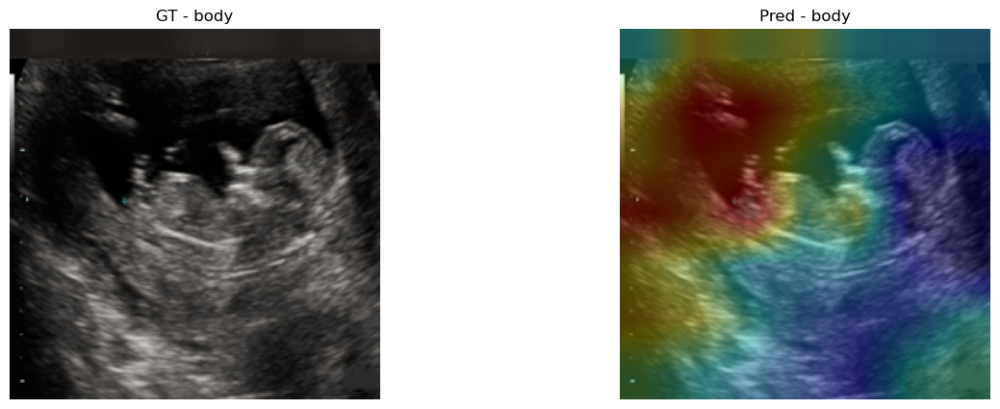

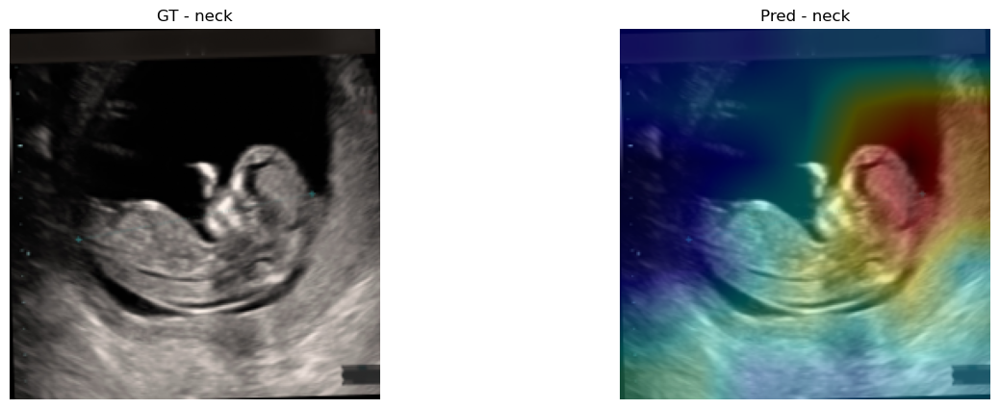

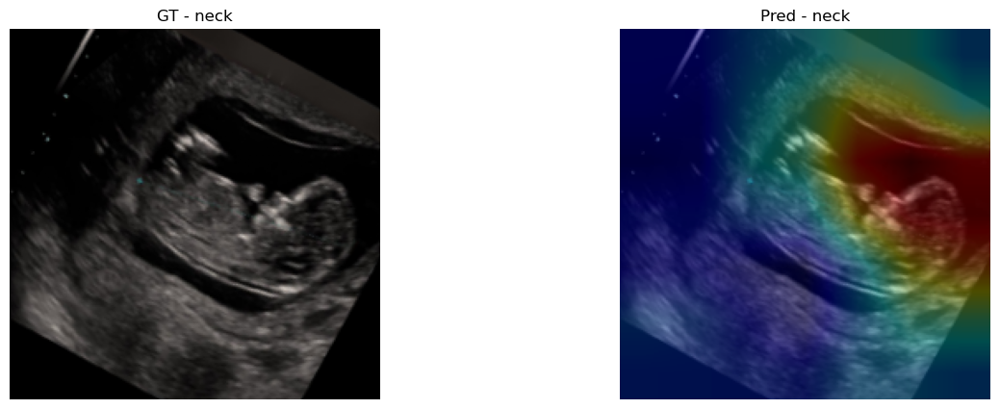

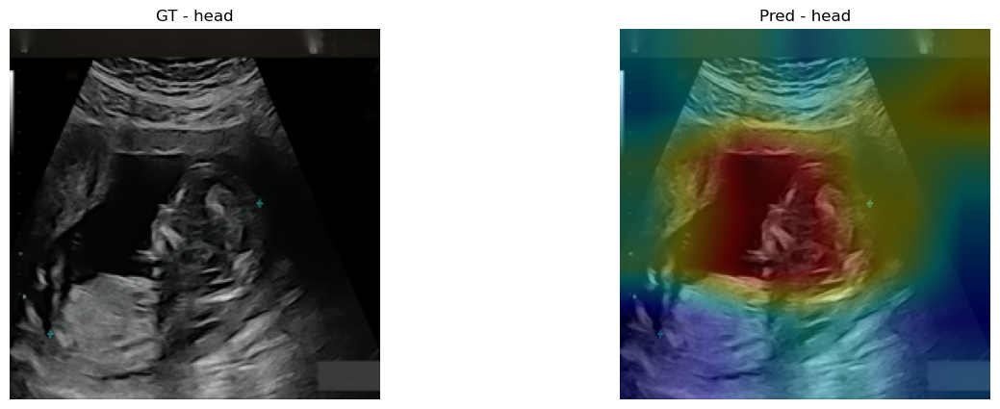

...

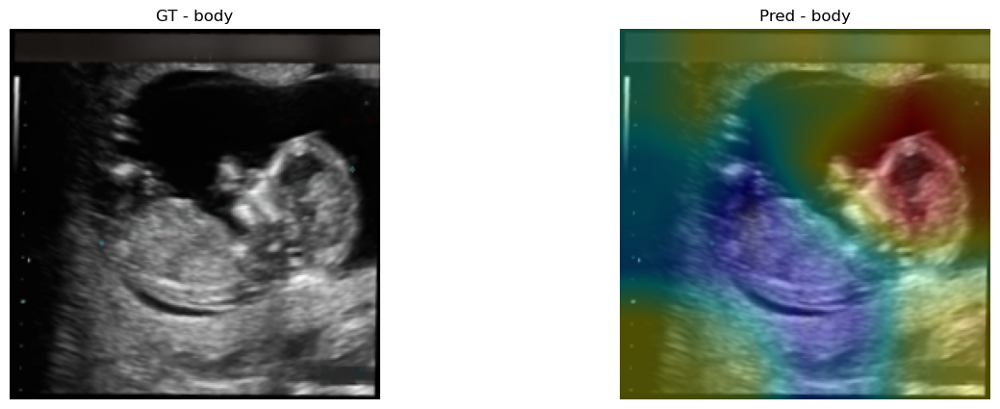

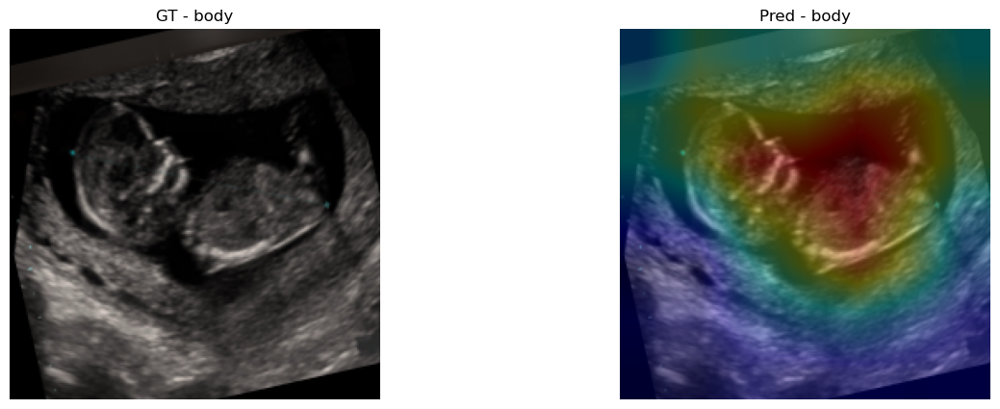

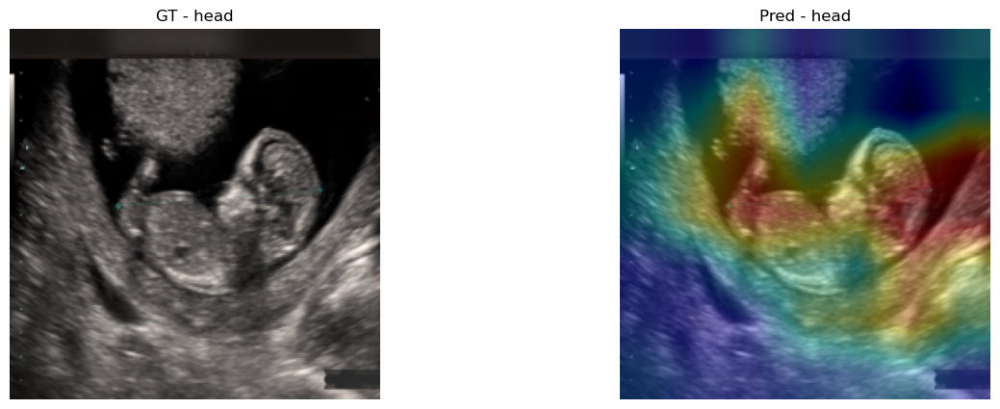

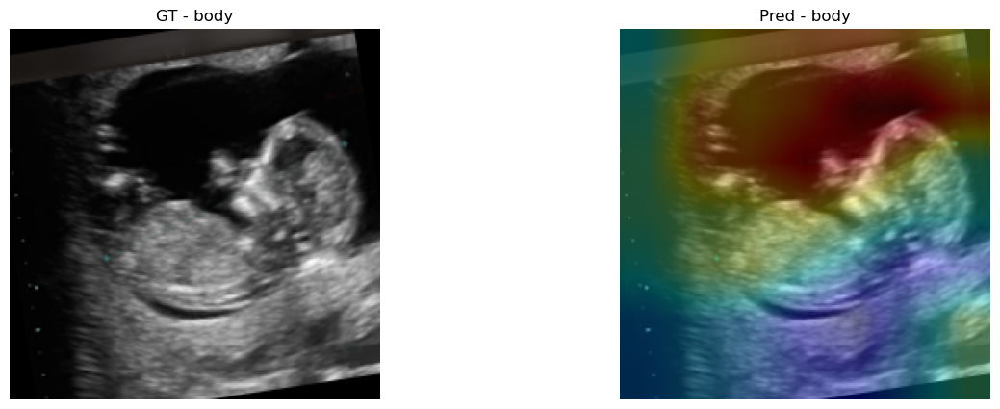

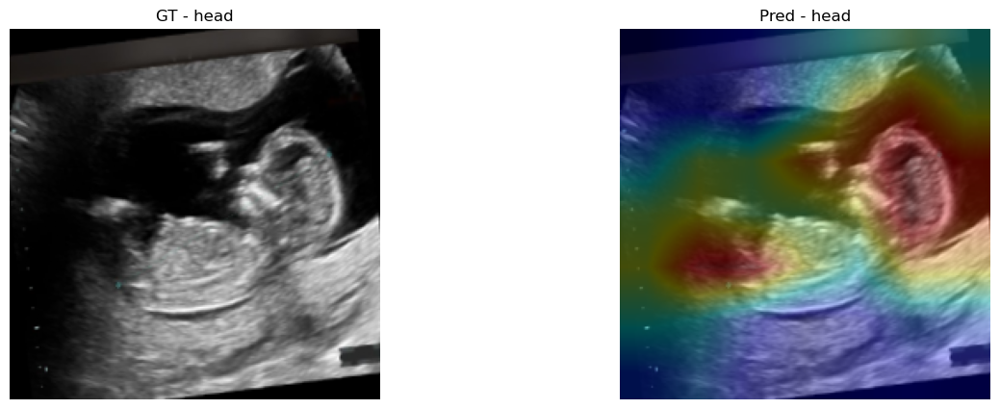

In [64]:
for i in range(len(x_test)):
  plt.figure(figsize=(15, 5))
  plt.subplot(1, 2, 1)
  plt.imshow(x_test[i])
  plt.title(f'GT - {labels[y_test[i]]}')
  plt.axis('off')

  plt.subplot(1, 2, 2)
  plt.imshow(test_overlaid[i])
  plt.title(f'Pred - {labels[test_preds[i]]}')
  plt.axis('off')